## Kütüphaneler

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split # eğitim ve test ayrımı
from sklearn.preprocessing import StandardScaler # normalizasyon için
from sklearn.impute import SimpleImputer # eksik veriler için
from sklearn.preprocessing import LabelEncoder # kategorik veriler için
from sklearn.preprocessing import OneHotEncoder # kategorik verilerin vektör olarak temsili
import missingno as msno # null olan değerlerin grafiği için
import statsmodels.api as sm
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, mean_squared_error, r2_score, roc_auc_score,roc_curve
from yellowbrick.classifier import ConfusionMatrix
from pandas_profiling import ProfileReport
import warnings
warnings.filterwarnings("ignore")

# Classifier için kullanılacak modüller 
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegressionCV
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import SpectralClustering



## Veri Önişleme

In [2]:
data = pd.read_csv("train.csv")
data.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

In [5]:
data.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [6]:
data.isnull().sum().sum()

0

In [7]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
battery_power,2000.0,1238.51850,439.418206,501.0,851.75,1226.0,1615.25,1998.0
blue,2000.0,0.49500,0.500100,0.0,0.00,0.0,1.00,1.0
clock_speed,2000.0,1.52225,0.816004,0.5,0.70,1.5,2.20,3.0
dual_sim,2000.0,0.50950,0.500035,0.0,0.00,1.0,1.00,1.0
fc,2000.0,4.30950,4.341444,0.0,1.00,3.0,7.00,19.0
four_g,2000.0,0.52150,0.499662,0.0,0.00,1.0,1.00,1.0
int_memory,2000.0,32.04650,18.145715,2.0,16.00,32.0,48.00,64.0
m_dep,2000.0,0.50175,0.288416,0.1,0.20,0.5,0.80,1.0
mobile_wt,2000.0,140.24900,35.399655,80.0,109.00,141.0,170.00,200.0
n_cores,2000.0,4.52050,2.287837,1.0,3.00,4.0,7.00,8.0


<AxesSubplot:>

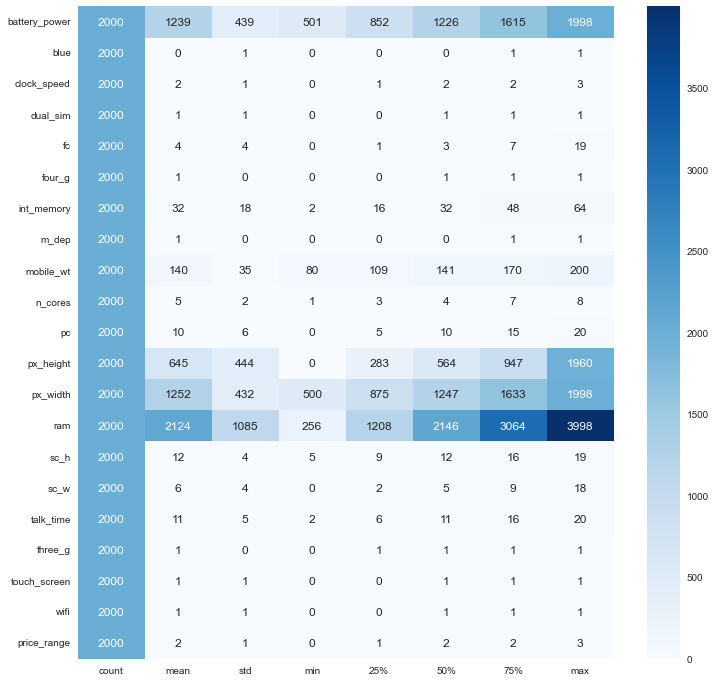

In [63]:
df1 = pd.DataFrame(index=data.columns,
                   columns=data.describe().T.columns, data=data.describe().T)

f, ax = plt.subplots(figsize=(12, 12))

sns.heatmap(df1, annot=True, fmt=".0f", cmap="Blues")


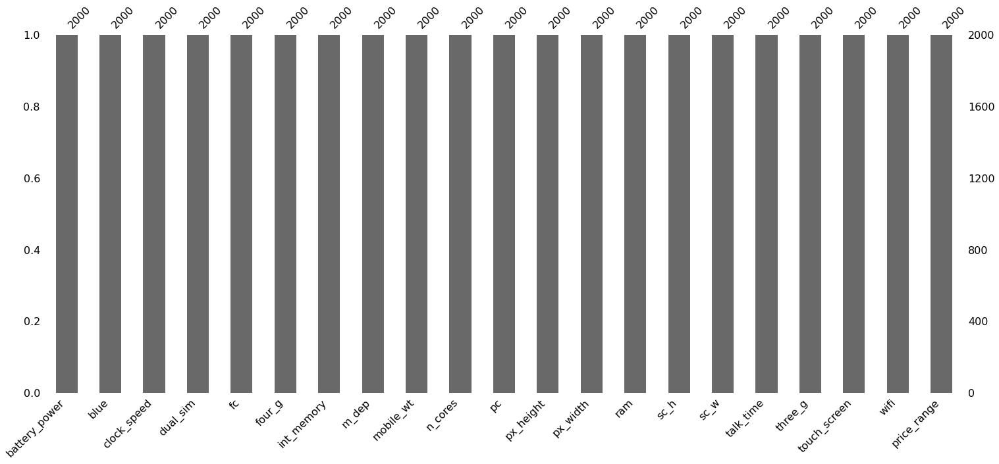

In [8]:
msno.bar(data);

In [46]:
data.profile_report()
# pip install ipywidgets, pip install pandas-profiling


Render HTML: 100%|██████████| 1/1 [00:04<00:00,  4.94s/it]


In [3]:
x = data.iloc[:, :-1].values # bağımsız değişkenler
y = data.iloc[:, -1:].values # bağımlı değişkenler


## Eksik Verilerin Doldurulması

In [10]:
imputer = SimpleImputer(missing_values=np.NaN, strategy="mean")
imputer = imputer.fit(x)
x = imputer.transform(x)

## Verilerin Görselleştirilmesi

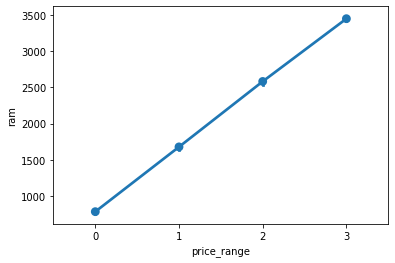

In [11]:
sns.pointplot(x = "price_range", y = "ram", data = data);


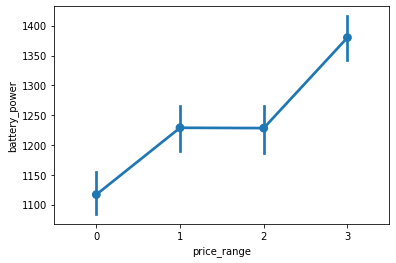

In [12]:
sns.pointplot(x = "price_range", y = "battery_power", data = data);


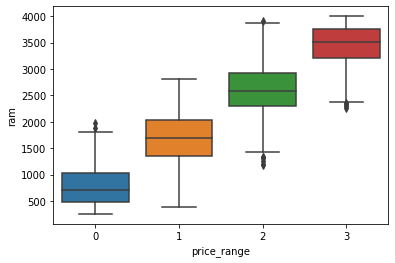

In [13]:
sns.boxplot(x = "price_range", y = "ram", data = data);

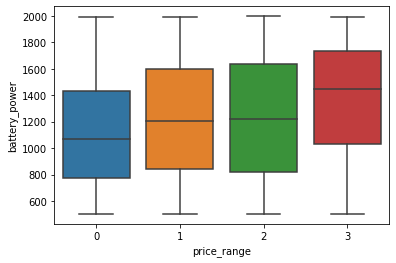

In [5]:
sns.boxplot(x = "price_range", y = "battery_power", data=data);


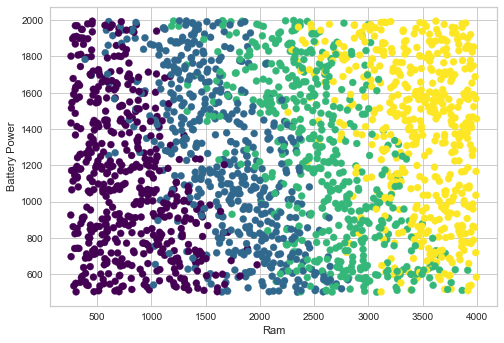

In [82]:
plt.scatter(x="ram", y="battery_power", c="price_range",
            data=data, cmap="viridis")

plt.xlabel("Ram")
plt.ylabel("Battery Power");


Text(0, 0.5, 'Frequency')

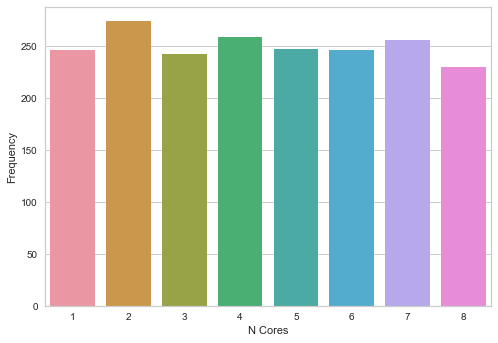

In [94]:
# sns.barplot(x="n_cores", y=data.groupby(by="n_cores")["n_cores"].count(),
#             data=data)
sns.barplot(x="n_cores", y=data["n_cores"].value_counts(),
            data=data)

plt.xlabel("N Cores")
plt.ylabel("Frequency")


In [105]:
# for i in data:
#     plt.hist(data[i])
#     plt.xlabel(i)
#     plt.show()

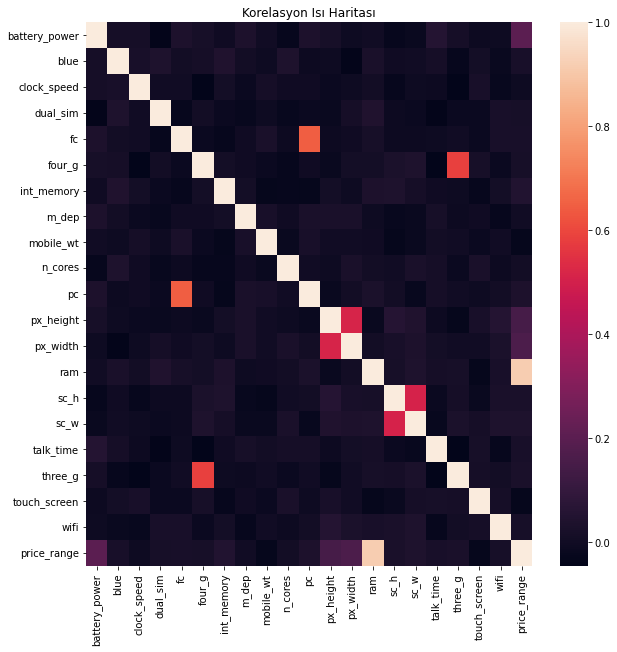

In [9]:
correlation = data.corr()
plt.figure(figsize=(10, 10))
sns.heatmap(correlation)
plt.title("Korelasyon Isı Haritası");


<AxesSubplot:>

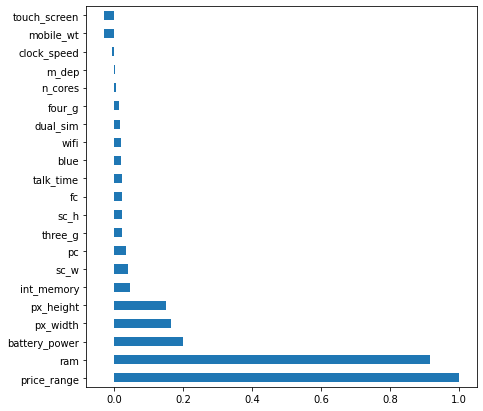

In [19]:
plt.figure(figsize=(7,7))
correlation.sort_values(by="price_range", ascending=False).iloc[0].sort_values(ascending=False).plot(kind="barh")


<AxesSubplot:xlabel='touch_screen', ylabel='ram'>

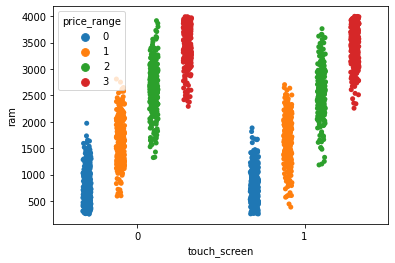

In [16]:
sns.stripplot(x="touch_screen", y="ram", hue="price_range", data=data,
              dodge=True)


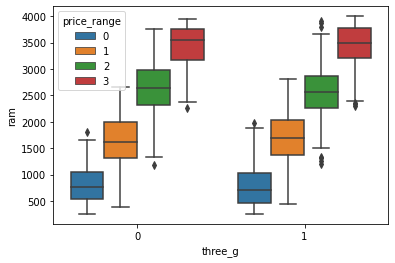

In [24]:
sns.boxplot(x = "three_g", y = "ram", hue="price_range", data=data);


<AxesSubplot:xlabel='four_g', ylabel='ram'>

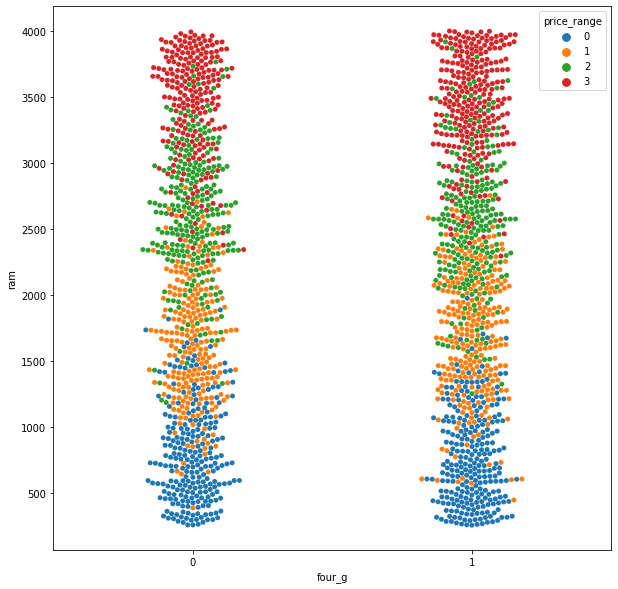

In [17]:
plt.figure(figsize=(10, 10))
sns.swarmplot(x="four_g", y="ram", hue="price_range", data=data)


<AxesSubplot:xlabel='wifi', ylabel='ram'>

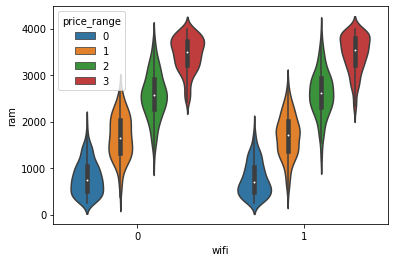

In [32]:
sns.violinplot(x="wifi", y="ram", hue="price_range",
               data=data)


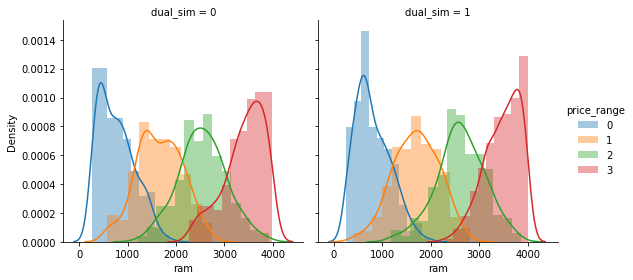

In [18]:
g = sns.FacetGrid(data, col="dual_sim", hue="price_range", height=4)
g = (g.map(sns.distplot, "ram").add_legend())

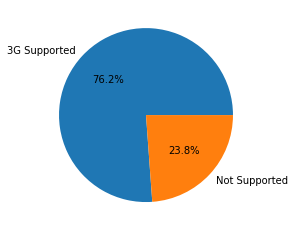

In [19]:
labels = ["3G Supported", "Not Supported"]
threeG = data["three_g"].value_counts().values
plt.pie(threeG, labels=labels, autopct='%1.1f%%');

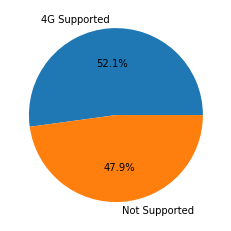

In [20]:
labels = ["4G Supported",'Not Supported']
fourG = data["four_g"].value_counts().values
plt.pie(fourG, labels=labels, autopct="%1.1f%%");


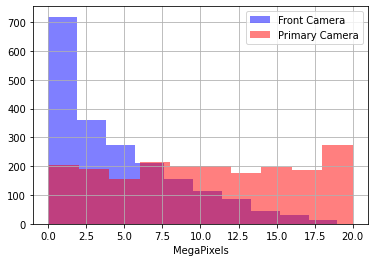

In [21]:
data["fc"].hist(color="blue", alpha=0.5, label="Front Camera")
data["pc"].hist(color="red", alpha=0.5, label="Primary Camera")
plt.xlabel("MegaPixels")
plt.legend();

In [59]:
import plotly.graph_objects as go
import plotly.express as px

px.scatter(data, x='price_range', y='ram', color='battery_power',
          animation_frame='int_memory',size='pc')

## Verilerin eğitim ve test için bölünmesi

In [4]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Verilerin Ölçeklenmesi

In [5]:
sc = StandardScaler()

X_train = sc.fit_transform(x_train)
X_test = sc.transform(x_test)

In [38]:
log_reg = LogisticRegression(random_state=0)
log_reg.fit(X_train, y_train)

y_train_pred = log_reg.predict(X_train)
y_test_pred = log_reg.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 97.71428571428571
Test Data Accuracy 94.83333333333334
Confusion Matrix

 [[155   3   0   0]
 [  4 133   9   0]
 [  0  10 135   2]
 [  0   0   3 146]]
Classification Report

               precision    recall  f1-score   support

           0       0.97      0.98      0.98       158
           1       0.91      0.91      0.91       146
           2       0.92      0.92      0.92       147
           3       0.99      0.98      0.98       149

    accuracy                           0.95       600
   macro avg       0.95      0.95      0.95       600
weighted avg       0.95      0.95      0.95       600



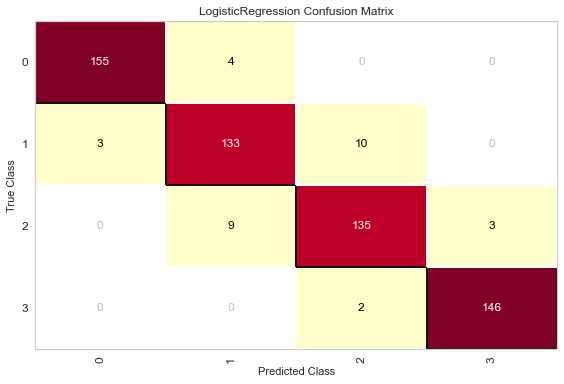

<AxesSubplot:title={'center':'LogisticRegression Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [43]:
cm = ConfusionMatrix(log_reg, classes=[0, 1, 2, 3])
cm.fit(X_train, y_train)
cm.score(X_test, y_test)
cm.poof()


In [111]:
loj = LogisticRegressionCV()
loj_tuned = loj.fit(X_train, y_train)

y_train_pred = loj_tuned.predict(X_train)
y_test_pred = loj_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))

Train Data Accuracy 98.21428571428571
Test Data Accuracy 96.5
Confusion Matrix

 [[157   3   0   0]
 [  2 136   5   0]
 [  0   7 140   2]
 [  0   0   2 146]]
Classification Report

               precision    recall  f1-score   support

           0       0.99      0.98      0.98       160
           1       0.93      0.95      0.94       143
           2       0.95      0.94      0.95       149
           3       0.99      0.99      0.99       148

    accuracy                           0.96       600
   macro avg       0.96      0.96      0.96       600
weighted avg       0.97      0.96      0.97       600



In [25]:
model1 = sm.OLS(y_test_pred, x_test).fit()
print(model1.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.962
Model:                            OLS   Adj. R-squared (uncentered):              0.961
Method:                 Least Squares   F-statistic:                              738.9
Date:                Sun, 31 Jul 2022   Prob (F-statistic):                        0.00
Time:                        18:25:29   Log-Likelihood:                         -240.70
No. Observations:                 600   AIC:                                      521.4
Df Residuals:                     580   BIC:                                      609.3
Df Model:                          20                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

Accuracy score is only for classification problems. 

For regression problems you can use:

R2 Score, MSE (Mean Squared Error), RMSE (Root Mean Squared Error).


In [26]:
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)

y_train_pred = lin_reg.predict(X_train)
y_test_pred = lin_reg.predict(X_test)

print("Test Data R2 Score:", r2_score(y_test_pred, y_test) * 100)
print("Test Data Mean Squared Error:", mean_squared_error(y_test_pred, y_test) * 100)


Test Data R2 Score: 91.0846574899639
Test Data Mean Squared Error: 10.66646938157174


In [93]:
nb = GaussianNB()
nb.fit(X_train, y_train)

y_train_pred = nb.predict(X_train) 
y_test_pred = nb.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))

Train Data Accuracy 82.5
Test Data Accuracy 80.33333333333333
Confusion Matrix

 [[146  15   0   0]
 [ 13  96  30   0]
 [  0  35 101   9]
 [  0   0  16 139]]
Classification Report

               precision    recall  f1-score   support

           0       0.92      0.91      0.91       161
           1       0.66      0.69      0.67       139
           2       0.69      0.70      0.69       145
           3       0.94      0.90      0.92       155

    accuracy                           0.80       600
   macro avg       0.80      0.80      0.80       600
weighted avg       0.81      0.80      0.81       600



In [44]:
svc_model = SVC(kernel="rbf")
svc_model.fit(X_train, y_train)

y_train_pred = svc_model.predict(X_train) 
y_test_pred = svc_model.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 98.07142857142857
Test Data Accuracy 86.33333333333333
Confusion Matrix

 [[143  13   0   0]
 [ 16 116  15   0]
 [  0  17 122  11]
 [  0   0  10 137]]
Classification Report

               precision    recall  f1-score   support

           0       0.90      0.92      0.91       156
           1       0.79      0.79      0.79       147
           2       0.83      0.81      0.82       150
           3       0.93      0.93      0.93       147

    accuracy                           0.86       600
   macro avg       0.86      0.86      0.86       600
weighted avg       0.86      0.86      0.86       600



In [114]:
svc_params = {
    "C": [0.0001, 0.001, 0.1, 1, 5, 10, 50, 100],
    "gamma": [0.0001, 0.001, 0.1, 1, 5, 10, 50, 100]
}

svc = SVC()
svc_cv = GridSearchCV(svc, svc_params,
                            cv=10, n_jobs=-1, verbose=2)
svc_cv.fit(X_train, y_train)

Fitting 10 folds for each of 8 candidates, totalling 80 fits


GridSearchCV(cv=10, estimator=SVC(), n_jobs=-1,
             param_grid={'gamma': [0.0001, 0.001, 0.1, 1, 5, 10, 50, 100]},
             verbose=2)

In [115]:
svc_cv.best_params_

{'gamma': 0.1}

In [122]:
svc_tuned = SVC(C = 10, gamma = 0.1)
svc_tuned.fit(X_train, y_train)

y_train_pred = svc_tuned.predict(X_train) 
y_test_pred = svc_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))



Train Data Accuracy 100.0
Test Data Accuracy 83.0
Confusion Matrix

 [[138  13   0   0]
 [ 21 113  17   1]
 [  0  20 115  15]
 [  0   0  15 132]]
Classification Report

               precision    recall  f1-score   support

           0       0.87      0.91      0.89       151
           1       0.77      0.74      0.76       152
           2       0.78      0.77      0.77       150
           3       0.89      0.90      0.89       147

    accuracy                           0.83       600
   macro avg       0.83      0.83      0.83       600
weighted avg       0.83      0.83      0.83       600



In [123]:
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)

y_train_pred = knn.predict(X_train) 
y_test_pred = knn.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 69.5
Test Data Accuracy 51.5
Confusion Matrix

 [[118  59  13   2]
 [ 31  58  54  24]
 [ 10  25  62  51]
 [  0   4  18  71]]
Classification Report

               precision    recall  f1-score   support

           0       0.74      0.61      0.67       192
           1       0.40      0.35      0.37       167
           2       0.42      0.42      0.42       148
           3       0.48      0.76      0.59        93

    accuracy                           0.52       600
   macro avg       0.51      0.54      0.51       600
weighted avg       0.53      0.52      0.51       600



In [100]:
knn_params = {
    "n_neighbors": np.arange(1, 50),
    "leaf_size" : list(range(1,50)),
    "p":[1,2]
}
knn = KNeighborsClassifier()

knn_cv = GridSearchCV(knn, knn_params, cv=10)
knn_cv.fit(X_train, y_train)


GridSearchCV(cv=10, estimator=KNeighborsClassifier(), param_grid={'p': [1, 2]})

In [101]:
knn_cv.best_params_

{'p': 1}

In [104]:
knn_tuned = KNeighborsClassifier(n_neighbors=41, leaf_size=1, p=1)
knn_tuned.fit(X_train, y_train)

y_train_pred = knn_tuned.predict(X_train)
y_test_pred = knn_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 73.57142857142858
Test Data Accuracy 69.0
Confusion Matrix

 [[137  43   3   0]
 [ 18  76  27   5]
 [  4  24  94  36]
 [  0   3  23 107]]
Classification Report

               precision    recall  f1-score   support

           0       0.86      0.75      0.80       183
           1       0.52      0.60      0.56       126
           2       0.64      0.59      0.62       158
           3       0.72      0.80      0.76       133

    accuracy                           0.69       600
   macro avg       0.69      0.69      0.68       600
weighted avg       0.70      0.69      0.69       600



In [14]:
X_train_scaled = sc.transform(X_train)
X_test_scaled = sc.transform(X_test)

mlpc = MLPClassifier().fit(X_train_scaled, y_train)

y_train_pred = mlpc.predict(X_train)
y_test_pred = mlpc.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 25.785714285714285
Test Data Accuracy 23.5
Confusion Matrix

 [[ 29  38  45  42]
 [ 16  15  13   9]
 [  7   7   8   8]
 [107  86  81  89]]
Classification Report

               precision    recall  f1-score   support

           0       0.18      0.19      0.19       154
           1       0.10      0.28      0.15        53
           2       0.05      0.27      0.09        30
           3       0.60      0.25      0.35       363

    accuracy                           0.23       600
   macro avg       0.24      0.25      0.19       600
weighted avg       0.42      0.23      0.28       600



In [132]:
mlpc_params = {
    "alpha": [0.1, 0.01, 0.005, 0.0001, 0.00001],
    "hidden_layer_sizes": [(10, 10, 10),
                           (100, 100, 100),
                           (100, 100),
                           (3, 5),
                           (5, 3)],
    "solver": ["lbfgs", "adam", "sgd"],
    "activation": ["relu", "logistic"]
}

mlpc = MLPClassifier()
mlpc_cv = GridSearchCV(mlpc, mlpc_params,
                             cv=10, n_jobs=-1, verbose=2)

mlpc_cv.fit(X_train_scaled, y_train)



Fitting 10 folds for each of 2 candidates, totalling 20 fits


GridSearchCV(cv=10, estimator=MLPClassifier(), n_jobs=-1,
             param_grid={'activation': ['relu', 'logistic']}, verbose=2)

In [133]:
mlpc_cv.best_params_

{'activation': 'logistic'}

In [136]:
mlpc_tuned = MLPClassifier(activation="logistic",
                           alpha= 0.1,
                           hidden_layer_sizes=(100, 100, 100),
                           solver="adam")
mlpc_tuned.fit(X_train, y_train)

y_train_pred = mlpc_tuned.predict(X_train)
y_test_pred = mlpc_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))
                       

Train Data Accuracy 98.28571428571429
Test Data Accuracy 97.0
Confusion Matrix

 [[158   3   0   0]
 [  1 137   3   0]
 [  0   6 140   1]
 [  0   0   4 147]]
Classification Report

               precision    recall  f1-score   support

           0       0.99      0.98      0.99       161
           1       0.94      0.97      0.95       141
           2       0.95      0.95      0.95       147
           3       0.99      0.97      0.98       151

    accuracy                           0.97       600
   macro avg       0.97      0.97      0.97       600
weighted avg       0.97      0.97      0.97       600



In [46]:
dtc_model = DecisionTreeClassifier()
dtc_model.fit(X_train, y_train)

y_train_pred = dtc_model.predict(X_train)
y_test_pred = dtc_model.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))



Train Data Accuracy 100.0
Test Data Accuracy 83.0
Confusion Matrix

 [[142  16   0   0]
 [ 17 113  23   0]
 [  0  17 115  20]
 [  0   0   9 128]]
Classification Report

               precision    recall  f1-score   support

           0       0.89      0.90      0.90       158
           1       0.77      0.74      0.76       153
           2       0.78      0.76      0.77       152
           3       0.86      0.93      0.90       137

    accuracy                           0.83       600
   macro avg       0.83      0.83      0.83       600
weighted avg       0.83      0.83      0.83       600



In [51]:
dtc_params = {
    'criterion': ['gini', 'entropy'],
    "max_depth": list(range(1, 10)),
    "min_samples_split": list(range(2, 50)),
    'min_samples_leaf': range(1, 10)
}

dtc = DecisionTreeClassifier()
dtc_cv = GridSearchCV(dtc, dtc_params, cv=10, n_jobs=None, verbose=2) # 9m 52.6s
# dtc_cv = GridSearchCV(dtc, dtc_params, cv=10, n_jobs=-1, verbose=2)
dtc_cv.fit(X_train, y_train)


Fitting 10 folds for each of 7776 candidates, totalling 77760 fits
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_l

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9],
                         'min_samples_leaf': range(1, 10),
                         'min_samples_split': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                               12, 13, 14, 15, 16, 17, 18, 19,
                                               20, 21, 22, 23, 24, 25, 26, 27,
                                               28, 29, 30, 31, ...]},
             verbose=2)

In [52]:
print("En iyi parametreler:", dtc_cv.best_params_)

En iyi parametreler: {'criterion': 'entropy', 'max_depth': 8, 'min_samples_leaf': 2, 'min_samples_split': 2}


In [159]:
dtc_tuned = DecisionTreeClassifier(criterion = "entropy", max_depth=8, min_samples_leaf=2, min_samples_split=2)
dtc_tuned.fit(X_train, y_train)

y_train_pred = dtc_tuned.predict(X_train)
y_test_pred = dtc_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 97.85714285714285
Test Data Accuracy 84.83333333333334
Confusion Matrix

 [[147  16   0   0]
 [ 12 117  22   0]
 [  0  13 114  17]
 [  0   0  11 131]]
Classification Report

               precision    recall  f1-score   support

           0       0.92      0.90      0.91       163
           1       0.80      0.77      0.79       151
           2       0.78      0.79      0.78       144
           3       0.89      0.92      0.90       142

    accuracy                           0.85       600
   macro avg       0.85      0.85      0.85       600
weighted avg       0.85      0.85      0.85       600



In [16]:
rf = RandomForestClassifier().fit(X_train, y_train)
rf.fit(X_train, y_train)

y_train_pred = rf.predict(X_train)
y_test_pred = rf.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))

Train Data Accuracy 100.0
Test Data Accuracy 87.66666666666667
Confusion Matrix

 [[152  14   0   0]
 [  7 117  22   0]
 [  0  15 115   6]
 [  0   0  10 142]]
Classification Report

               precision    recall  f1-score   support

           0       0.96      0.92      0.94       166
           1       0.80      0.80      0.80       146
           2       0.78      0.85      0.81       136
           3       0.96      0.93      0.95       152

    accuracy                           0.88       600
   macro avg       0.87      0.87      0.87       600
weighted avg       0.88      0.88      0.88       600



In [146]:
rf_params = {
    "max_depth": [2, 3, 5, 8, 10],
    "max_features": [2, 5, 8],
    "n_estimators": [10, 500, 1000],
    "min_samples_split": [2, 5, 10] 
}

rf_model = RandomForestClassifier()
rf_cv = GridSearchCV(rf_model, rf_params,
                           cv=10, n_jobs=-1, verbose=2)
rf_cv.fit(X_train, y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=10, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'min_samples_split': [2, 5, 10]}, verbose=2)

In [147]:
rf_cv.best_params_

{'min_samples_split': 2}

In [148]:
rf_tuned = RandomForestClassifier(max_depth=10,
                        max_features=8,
                        min_samples_split=2,
                        n_estimators=1000)
rf_tuned.fit(X_train, y_train) 


y_train_pred = rf_tuned.predict(X_train)
y_test_pred = rf_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))

Train Data Accuracy 100.0
Test Data Accuracy 88.33333333333333
Confusion Matrix

 [[147  11   0   0]
 [ 12 123  18   0]
 [  0  12 120   8]
 [  0   0   9 140]]
Classification Report

               precision    recall  f1-score   support

           0       0.92      0.93      0.93       158
           1       0.84      0.80      0.82       153
           2       0.82      0.86      0.84       140
           3       0.95      0.94      0.94       149

    accuracy                           0.88       600
   macro avg       0.88      0.88      0.88       600
weighted avg       0.88      0.88      0.88       600



Text(0.5, 0, 'Değişken Önem Düzeyleri')

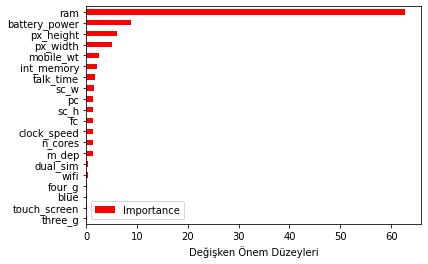

In [156]:
Importance = pd.DataFrame({"Importance": rf_tuned.feature_importances_ * 100}, index=data.iloc[:, :-1].columns)
Importance.sort_values(by = "Importance", axis = 0, ascending = True).plot(kind = "barh", color = "r")
plt.xlabel("Değişken Önem Düzeyleri")


In [65]:
abc = AdaBoostClassifier()
abc.fit(X_train, y_train)

y_train_pred = abc.predict(X_train)
y_test_pred = abc.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 64.92857142857143
Test Data Accuracy 67.33333333333333
Confusion Matrix

 [[ 73   3   0   0]
 [ 86 136  26   0]
 [  0   7 112  65]
 [  0   0   9  83]]
Classification Report

               precision    recall  f1-score   support

           0       0.46      0.96      0.62        76
           1       0.93      0.55      0.69       248
           2       0.76      0.61      0.68       184
           3       0.56      0.90      0.69        92

    accuracy                           0.67       600
   macro avg       0.68      0.75      0.67       600
weighted avg       0.76      0.67      0.68       600



In [75]:
from tkinter import Grid


abc = AdaBoostClassifier()
abc_params = {
    'n_estimators': [50, 70, 90, 120, 180, 200],
    'learning_rate': [0.001, 0.01, 0.1, 1, 10],
    'algorithm': ['SAMME', 'SAMME.R']
}

# abc_cv = GridSearchCV(abc, abc_params, n_jobs=None, cv=10, verbose=2) #2m 36.4s
abc_cv = GridSearchCV(abc, abc_params, n_jobs=16, cv=10, verbose=2) #41.5s
# abc_cv = GridSearchCV(abc, abc_params, n_jobs=-1, cv=10, verbose=2) #37.9s
abc_cv.fit(X_train, y_train)


Fitting 10 folds for each of 60 candidates, totalling 600 fits


GridSearchCV(cv=10, estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid={'algorithm': ['SAMME', 'SAMME.R'],
                         'learning_rate': [0.001, 0.01, 0.1, 1, 10],
                         'n_estimators': [50, 70, 90, 120, 180, 200]},
             verbose=2)

In [76]:
abc_cv.best_params_

{'algorithm': 'SAMME', 'learning_rate': 0.1, 'n_estimators': 200}

In [161]:
abc_tuned = AdaBoostClassifier(algorithm="SAMME", learning_rate=0.1, n_estimators=200)
abc_tuned.fit(X_train, y_train)

y_train_pred = abc_tuned.predict(X_train)
y_test_pred = abc_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))



Train Data Accuracy 73.78571428571429
Test Data Accuracy 73.16666666666667
Confusion Matrix

 [[133  22   0   0]
 [ 26 103  37   0]
 [  0  20  61   6]
 [  0   1  49 142]]
Classification Report

               precision    recall  f1-score   support

           0       0.84      0.86      0.85       155
           1       0.71      0.62      0.66       166
           2       0.41      0.70      0.52        87
           3       0.96      0.74      0.84       192

    accuracy                           0.73       600
   macro avg       0.73      0.73      0.72       600
weighted avg       0.78      0.73      0.74       600



In [6]:
gbc = GradientBoostingClassifier()
gbc.fit(X_train, y_train)

y_train_pred = gbc.predict(X_train)
y_test_pred = gbc.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 100.0
Test Data Accuracy 89.0
Confusion Matrix

 [[151  11   0   0]
 [  8 123  17   0]
 [  0  12 121   9]
 [  0   0   9 139]]
Classification Report

               precision    recall  f1-score   support

           0       0.95      0.93      0.94       162
           1       0.84      0.83      0.84       148
           2       0.82      0.85      0.84       142
           3       0.94      0.94      0.94       148

    accuracy                           0.89       600
   macro avg       0.89      0.89      0.89       600
weighted avg       0.89      0.89      0.89       600



In [17]:
gbc_params = {
    "learning_rate": [0.001, 0.01, 0.1, 0.05],
    "n_estimators": [100, 500, 1000],
    "max_depth": [3, 5, 10],
    "min_samples_split": [2, 5, 10]
}

gbc = GradientBoostingClassifier()
gbc_cv = GridSearchCV(gbc, gbc_params, n_jobs=-1, cv=10, verbose=2)
gbc_cv.fit(X_train, y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=10, estimator=GradientBoostingClassifier(), n_jobs=-1,
             param_grid={'min_samples_split': [2, 5, 10]}, verbose=2)

In [18]:
gbc_cv.best_params_

{'min_samples_split': 10}

In [24]:
gbc_tuned = GradientBoostingClassifier(learning_rate=0.1, n_estimators=500, max_depth=5, min_samples_split=10)
gbc_tuned.fit(X_train, y_train)

y_train_pred = gbc_tuned.predict(X_train)
y_test_pred = gbc_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 100.0
Test Data Accuracy 89.33333333333333
Confusion Matrix

 [[152  11   0   0]
 [  7 123  16   0]
 [  0  12 122   9]
 [  0   0   9 139]]
Classification Report

               precision    recall  f1-score   support

           0       0.96      0.93      0.94       163
           1       0.84      0.84      0.84       146
           2       0.83      0.85      0.84       143
           3       0.94      0.94      0.94       148

    accuracy                           0.89       600
   macro avg       0.89      0.89      0.89       600
weighted avg       0.89      0.89      0.89       600



In [28]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)

y_train_pred = xgb.predict(X_train)
y_test_pred = xgb.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 100.0
Test Data Accuracy 90.0
Confusion Matrix

 [[152   8   0   0]
 [  7 126  14   0]
 [  0  12 124  10]
 [  0   0   9 138]]
Classification Report

               precision    recall  f1-score   support

           0       0.96      0.95      0.95       160
           1       0.86      0.86      0.86       147
           2       0.84      0.85      0.85       146
           3       0.93      0.94      0.94       147

    accuracy                           0.90       600
   macro avg       0.90      0.90      0.90       600
weighted avg       0.90      0.90      0.90       600



In [38]:
xgb_params = {
    "n_estimators": [100, 500, 1000, 2000],
    "subsample": [0.6, 0.8, 1.0],
    "max_depth": [3, 4, 5, 6],
    "learning_rate": [0.1, 0.01, 0.02, 0.05],
    "min_samples_split": [2, 5, 10]
}

xgb = XGBClassifier()
xgb_cv = GridSearchCV(xgb, xgb_params, n_jobs=-1, cv=10, verbose=2)
xgb_cv.fit(X_train, y_train)                            


Fitting 10 folds for each of 3 candidates, totalling 30 fits
[21:50:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "min_samples_split" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




GridSearchCV(cv=10,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     gamma=None, gpu_id=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None, max_bin=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, predictor=None,
                                     random_state=None, reg_alpha=None,
                                     reg_lambda=None, ...),
             n_jobs=-1, param_grid={'min_samples_split': [2, 5, 10]},
             verbose=2)

In [39]:
xgb_cv.best_params_

{'min_samples_split': 2}

In [43]:
# xgb_tuned = XGBClassifier(n_estimators=100, subsample=0.8, max_depth=3, learning_rate=0.1, min_samples_split=2)

xgb_tuned = XGBClassifier(
    learning_rate=0.1,
    n_estimators=1000,
    max_depth=5,
    min_child_weight=1,
    gamma=0,
    subsample=0.8,
    colsample_bytree=0.8,
    objective='binary:logistic',
    nthread=4,
    scale_pos_weight=1,
    seed=27)

xgb_tuned.fit(X_train, y_train)

y_train_pred = xgb_tuned.predict(X_train)
y_test_pred = xgb_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


[21:53:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "scale_pos_weight" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


Train Data Accuracy 100.0
Test Data Accuracy 90.83333333333333
Confusion Matrix

 [[153   8   0   0]
 [  6 126  14   0]
 [  0  12 125   7]
 [  0   0   8 141]]
Classification Report

               precision    recall  f1-score   support

           0       0.96      0.95      0.96       161
           1       0.86      0.86      0.86       146
           2       0.85      0.87      0.86       144
           3       0.95      0.95      0.95       149

    accuracy                           0.91       600
   macro avg       0.91      0.91      0.91       600
weighted avg

In [50]:
lgbm = LGBMClassifier()
lgbm.fit(X_train, y_train)

y_train_pred = lgbm.predict(X_train)
y_test_pred = lgbm.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 100.0
Test Data Accuracy 90.5
Confusion Matrix

 [[151   7   0   0]
 [  8 127  15   0]
 [  0  12 125   8]
 [  0   0   7 140]]
Classification Report

               precision    recall  f1-score   support

           0       0.95      0.96      0.95       158
           1       0.87      0.85      0.86       150
           2       0.85      0.86      0.86       145
           3       0.95      0.95      0.95       147

    accuracy                           0.91       600
   macro avg       0.90      0.90      0.90       600
weighted avg       0.90      0.91      0.90       600



In [59]:
lgbm_params = {
    'n_estimators': [100, 500, 1000, 2000],
    'subsample': [0.6, 0.8, 1.0],
    'max_depth': [3, 4, 5, 6],
    'learning_rate': [0.1, 0.01, 0.02, 0.05],
    "min_child_samples": [5, 10, 20]
}

lgbm = LGBMClassifier()
lgbm_cv_model = GridSearchCV(lgbm, lgbm_params,
                             cv=10,
                             n_jobs=-1,
                             verbose=2)

lgbm_cv_model.fit(X_train, y_train)


Fitting 10 folds for each of 3 candidates, totalling 30 fits


GridSearchCV(cv=10, estimator=LGBMClassifier(), n_jobs=-1,
             param_grid={'min_child_samples': [5, 10, 20]}, verbose=2)

In [60]:
lgbm_cv_model.best_params_

{'min_child_samples': 10}

In [72]:
lgbm_tuned = LGBMClassifier(learning_rate = 0.1, 
                       max_depth = 5,
                       subsample = 0.6,
                       n_estimators = 1000,
                       min_child_samples = 10)
lgbm_tuned.fit(X_train, y_train)

y_train_pred = lgbm_tuned.predict(X_train)
y_test_pred = lgbm_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


Train Data Accuracy 100.0
Test Data Accuracy 90.33333333333333
Confusion Matrix

 [[153   9   0   0]
 [  6 126  15   0]
 [  0  11 125  10]
 [  0   0   7 138]]
Classification Report

               precision    recall  f1-score   support

           0       0.96      0.94      0.95       162
           1       0.86      0.86      0.86       147
           2       0.85      0.86      0.85       146
           3       0.93      0.95      0.94       145

    accuracy                           0.90       600
   macro avg       0.90      0.90      0.90       600
weighted avg       0.90      0.90      0.90       600



In [74]:
catb = CatBoostClassifier()
catb.fit(X_train, y_train)

y_train_pred = catb.predict(X_train)
y_test_pred = catb.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))

Learning rate set to 0.080496
0:	learn: 1.2887273	total: 172ms	remaining: 2m 51s
1:	learn: 1.2137233	total: 176ms	remaining: 1m 27s
2:	learn: 1.1459887	total: 181ms	remaining: 1m
3:	learn: 1.0725288	total: 186ms	remaining: 46.2s
4:	learn: 1.0131039	total: 190ms	remaining: 37.7s
5:	learn: 0.9466032	total: 194ms	remaining: 32.1s
6:	learn: 0.9044139	total: 199ms	remaining: 28.2s
7:	learn: 0.8598579	total: 204ms	remaining: 25.3s
8:	learn: 0.8180838	total: 208ms	remaining: 23s
9:	learn: 0.7893670	total: 212ms	remaining: 21s
10:	learn: 0.7487706	total: 216ms	remaining: 19.4s
11:	learn: 0.7193315	total: 220ms	remaining: 18.2s
12:	learn: 0.6923266	total: 225ms	remaining: 17.1s
13:	learn: 0.6636332	total: 230ms	remaining: 16.2s
14:	learn: 0.6373907	total: 235ms	remaining: 15.4s
15:	learn: 0.6119488	total: 240ms	remaining: 14.8s
16:	learn: 0.5958053	total: 245ms	remaining: 14.2s
17:	learn: 0.5798139	total: 250ms	remaining: 13.6s
18:	learn: 0.5628158	total: 254ms	remaining: 13.1s
19:	learn: 0.550

In [76]:
catb_params = {
    'iterations': [200,500],
    'learning_rate': [0.01,0.05, 0.1],
    'depth': [3,5,8] 
    }

catb = CatBoostClassifier()
catb_cv = GridSearchCV(catb, catb_params, cv=10, n_jobs = 16, verbose = 2)
catb_cv.fit(X_train, y_train)


Fitting 10 folds for each of 18 candidates, totalling 180 fits
0:	learn: 1.3279747	total: 22.8ms	remaining: 4.54s
1:	learn: 1.2860572	total: 44.8ms	remaining: 4.43s
2:	learn: 1.2402158	total: 65.5ms	remaining: 4.3s
3:	learn: 1.1952891	total: 86.9ms	remaining: 4.26s
4:	learn: 1.1448869	total: 108ms	remaining: 4.21s
5:	learn: 1.0972476	total: 129ms	remaining: 4.18s
6:	learn: 1.0555893	total: 151ms	remaining: 4.15s
7:	learn: 1.0269308	total: 172ms	remaining: 4.12s
8:	learn: 0.9969004	total: 194ms	remaining: 4.12s
9:	learn: 0.9648267	total: 216ms	remaining: 4.11s
10:	learn: 0.9299280	total: 237ms	remaining: 4.07s
11:	learn: 0.9001124	total: 258ms	remaining: 4.05s
12:	learn: 0.8756817	total: 282ms	remaining: 4.05s
13:	learn: 0.8517728	total: 306ms	remaining: 4.07s
14:	learn: 0.8245182	total: 332ms	remaining: 4.09s
15:	learn: 0.8074430	total: 354ms	remaining: 4.08s
16:	learn: 0.7914843	total: 376ms	remaining: 4.05s
17:	learn: 0.7680735	total: 397ms	remaining: 4.01s
18:	learn: 0.7480829	total

GridSearchCV(cv=10,
             estimator=<catboost.core.CatBoostClassifier object at 0x000002683016FD90>,
             n_jobs=16,
             param_grid={'depth': [3, 5, 8], 'iterations': [200, 500],
                         'learning_rate': [0.01, 0.05, 0.1]},
             verbose=2)

In [77]:
catb_cv.best_params_

{'depth': 8, 'iterations': 200, 'learning_rate': 0.05}

In [80]:
catb_tuned = CatBoostClassifier(iterations = 200, 
                          learning_rate = 0.05, 
                          depth = 8)

catb_tuned.fit(X_train, y_train)

y_train_pred = catb_tuned.predict(X_train)
y_test_pred = catb_tuned.predict(X_test)

print("Train Data Accuracy", accuracy_score(y_train_pred, y_train) * 100)
print("Test Data Accuracy", accuracy_score(y_test_pred, y_test) * 100)
print("Confusion Matrix\n\n", confusion_matrix(y_test_pred, y_test))
print("Classification Report\n\n", classification_report(y_test_pred, y_test))


0:	learn: 1.3279747	total: 22ms	remaining: 4.38s
1:	learn: 1.2860572	total: 42ms	remaining: 4.15s
2:	learn: 1.2402158	total: 62.1ms	remaining: 4.08s
3:	learn: 1.1952891	total: 83.1ms	remaining: 4.07s
4:	learn: 1.1448869	total: 103ms	remaining: 4.03s
5:	learn: 1.0972476	total: 123ms	remaining: 3.99s
6:	learn: 1.0555893	total: 144ms	remaining: 3.96s
7:	learn: 1.0269308	total: 164ms	remaining: 3.94s
8:	learn: 0.9969004	total: 195ms	remaining: 4.14s
9:	learn: 0.9648267	total: 218ms	remaining: 4.15s
10:	learn: 0.9299280	total: 240ms	remaining: 4.13s
11:	learn: 0.9001124	total: 265ms	remaining: 4.16s
12:	learn: 0.8756817	total: 287ms	remaining: 4.13s
13:	learn: 0.8517728	total: 310ms	remaining: 4.12s
14:	learn: 0.8245182	total: 333ms	remaining: 4.11s
15:	learn: 0.8074430	total: 371ms	remaining: 4.26s
16:	learn: 0.7914843	total: 403ms	remaining: 4.34s
17:	learn: 0.7680735	total: 432ms	remaining: 4.37s
18:	learn: 0.7480829	total: 463ms	remaining: 4.41s
19:	learn: 0.7253429	total: 497ms	remaini

In [163]:
X_train_scaled = sc.transform(X_train)
X_test_scaled = sc.transform(X_test)

modeller = [
    knn_tuned,
    log_reg,
    svc_tuned,
    nb,
    mlpc_tuned,
    dtc_tuned,
    rf_tuned,
    gbc_tuned,
    abc_tuned,
    catb_tuned,
    lgbm_tuned,
    xgb_tuned
]

for model in modeller:
    model_ismi = model.__class__.__name__

    if model_ismi == "MLPClassifier":
        y_pred = model.predict(X_test_scaled)
        dogruluk = accuracy_score(y_test, y_pred)
    else:
        y_pred = model.predict(X_test)
        dogruluk = accuracy_score(y_test, y_pred)

    print("-" * 28)
    print(model_ismi + ":")
    print("Accuracy: {:.4f}".format(dogruluk))


----------------------------
KNeighborsClassifier:
Accuracy: 0.6900
----------------------------
LogisticRegression:
Accuracy: 0.9483
----------------------------
SVC:
Accuracy: 0.8300
----------------------------
GaussianNB:
Accuracy: 0.8033
----------------------------
MLPClassifier:
Accuracy: 0.9700
----------------------------
DecisionTreeClassifier:
Accuracy: 0.8483
----------------------------
RandomForestClassifier:
Accuracy: 0.8833
----------------------------
GradientBoostingClassifier:
Accuracy: 0.8933
----------------------------
AdaBoostClassifier:
Accuracy: 0.7317
----------------------------
CatBoostClassifier:
Accuracy: 0.9100
----------------------------
LGBMClassifier:
Accuracy: 0.9033
----------------------------
XGBClassifier:
Accuracy: 0.9083


<AxesSubplot:xlabel='Accuracy', ylabel='Modeller'>

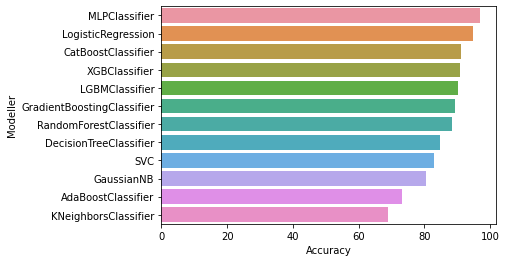

In [166]:
sonuclar = pd.DataFrame(columns = ["Modeller", "Accuracy"])

for model in modeller:
    model_ismi = model.__class__.__name__

    if model_ismi == "MLPClassifier":
        y_pred = model.predict(X_test_scaled)
        dogruluk = accuracy_score(y_test, y_pred)
    else:
        y_pred = model.predict(X_test)
        dogruluk = accuracy_score(y_test, y_pred)

    sonuc = pd.DataFrame([[model_ismi, dogruluk * 100]], columns = ["Modeller", "Accuracy"])
    sonuclar = sonuclar.append(sonuc)



sonuclar = sonuclar.sort_values(by = "Accuracy", ascending = False)
sns.barplot(x = "Accuracy", y = "Modeller", data = sonuclar)
plt.title("Modellerin Doğruluk Oranları")


In [6]:
mlpc_tuned = MLPClassifier(activation="logistic",
                           alpha= 0.1,
                           hidden_layer_sizes=(100, 100, 100),
                           solver="adam").fit(X_train, y_train)


mlpc_tuned.fit(X_train, y_train)

y_train_pred = mlpc_tuned.predict(X_train)
y_test_pred = mlpc_tuned.predict(X_test)


In [7]:
print(y_test_pred.shape)
print(y_train_pred.shape)

(600,)
(1400,)


X-Shape: (1000, 2)
Y-Shape: (1000,)
Counter({1: 250, 2: 250, 0: 250, 3: 250})
[-10.45765533  -3.30899488] 1
[-5.90962043 -7.80717036] 2
[-1.00497975  4.35530142] 0
[-6.63784922 -4.52085249] 3
[-6.3466658  -8.89940182] 2
[-4.67047183 -3.35527602] 3
[-5.62742066 -1.70195987] 3
[-6.91064247 -2.83731201] 3
[-1.76490462  5.03668554] 0
[-8.70416288 -4.39234621] 1


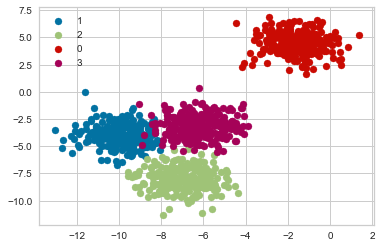

In [66]:
from numpy import where
from collections import Counter
from sklearn.datasets import make_blobs


X, y = make_blobs(n_samples=1000, centers=4, random_state=1)
print("X-Shape:", X.shape)
print("Y-Shape:", y.shape)

counter = Counter(y)
print(counter)

for i in range(10):
	print(X[i], y[i])

for label, _ in counter.items():
	row_ix = where(y == label)[0]
	plt.scatter(X[row_ix, 0], X[row_ix, 1], label=str(label))
plt.legend()
